## Forecasting the Yield Spread Using PCA, Vasicek and ARIMA Models

In [23]:
import os
wd = os.getcwd()
wd

'/Users/joshi27s/Desktop/Summer 2020/Yield'

In [32]:
import warnings
warnings.filterwarnings('ignore')

from math import sqrt
import datetime
from datetime import date, timedelta
import quandl
import numpy as np
import pandas as pd
import scipy
import statsmodels.api as sm

from fbprophet import Prophet # for forecasting via ML called "Prophet"
from fbprophet.plot import plot_plotly
import logging
logging.getLogger().setLevel(logging.ERROR) # mutes unimportant diagnostic messages



import sklearn.decomposition as sck_dec # has PCA functionalities
import sklearn.decomposition.pca as PCA
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler # for standardizing the Data
from sklearn.metrics import mean_squared_error
from statsmodels.tsa.arima_model import ARIMA
from matplotlib import pyplot
from pandas import DataFrame


import matplotlib
from matplotlib import pyplot
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
matplotlib.style.use('ggplot')
%matplotlib inline
import matplotlib.pyplot as plt


# standardizes the size of all plots, rather than typing plot(figsize = (12,6)) everytime
from pylab import rcParams
rcParams['figure.figsize'] = 12,6 

import seaborn as sns
from plotly import __version__ 
import cufflinks as cf 
from IPython.display import display, HTML, Image
import plotly
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.graph_objects as go

# set plotly to offline mode for easy reproducibilty
import plotly.offline as py
py.init_notebook_mode()

from statsmodels.tsa.stattools import adfuller,grangercausalitytests
from statsmodels.tsa.stattools import ccovf,ccf,periodogram
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
import math

# Deep learning packages
import keras
from keras.models import Sequential
from keras.layers import LSTM, Dense
from keras.layers import Dropout
from keras.layers import *
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from keras.callbacks import EarlyStopping




quandl.ApiConfig.api_key = '-kesKc4A8jkkBwyX3rSX'

Using TensorFlow backend.


In [25]:
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')

treas = ['FRED/DGS3MO',
           'FRED/DGS6MO',
           'FRED/DGS1',
           'FRED/DGS2',
           'FRED/DGS3',
           'FRED/DGS5',
           'FRED/DGS7',
           'FRED/DGS10',
           'FRED/DGS20',
           'FRED/DGS30',
           'FRED/T10Y3M'] # 10-Year Treasury Constant Maturity Minus 3-Month Treasury Constant Maturity

data = quandl.get(treas, start_date = "1993-10-01", end_date="2020-06-30",collapse = 'daily',date_parser=parser)
data.columns = ['tres3mo', 
                    'tres6mo',
                    'tres1y',
                    'tres2y',
                    'tres3y',
                    'tres5y',
                    'tres7y',
                    'tres10y',
                    'tres20y',
                    'tres30y',
                    'yieldsp']


In [26]:
data.head()

,tres3mo,tres6mo,tres1y,tres2y,tres3y,tres5y,tres7y,tres10y,tres20y,tres30y,yieldsp
Date,,,,,,,,,,,
1993-10-01,2.98,3.11,3.35,3.84,4.18,4.72,5.03,5.34,6.12,5.98,2.36
1993-10-04,3.02,3.17,3.35,3.85,4.16,4.71,5.04,5.34,6.10,5.99,2.32
1993-10-05,3.06,3.20,3.38,3.86,4.18,4.72,5.05,5.35,6.12,6.01,2.29
1993-10-06,3.04,3.19,3.36,3.85,4.16,4.70,5.05,5.35,6.12,6.01,2.31
1993-10-07,3.05,3.17,3.35,3.83,4.15,4.69,5.05,5.33,6.11,6.01,2.28


In [27]:
np.isnan(data).any() # check of data contains nan. If true => nan or inf are present

tres3mo    False
tres6mo    False
tres1y     False
tres2y     False
tres3y     False
tres5y     False
tres7y     False
tres10y    False
tres20y    False
tres30y     True
yieldsp    False
dtype: bool

In [28]:
# fill the NaN values with "ffill", and replaces inf values with 0
# ffill = forward fill

data_df = data.interpolate(method='spline', order=3).replace([np.inf, -np.inf], 0)

#data_df = data.fillna(method='ffill').replace([np.inf, -np.inf], 0)
np.isnan(data_df).any() # checks for NaN values => there are none

tres3mo    False
tres6mo    False
tres1y     False
tres2y     False
tres3y     False
tres5y     False
tres7y     False
tres10y    False
tres20y    False
tres30y    False
yieldsp    False
dtype: bool

In [7]:
data1 = data_df.loc[:, data.columns != 'yieldsp']
data_df.shape

(6691, 11)

In [29]:
fig_tres = data1.iplot(asFigure=True, kind='scatter', xTitle='Year', 
                                                 yTitle='Treasury Rates')
fig_tres

In [30]:
##Plot an interactive 3D yield curve for varying maturities

ids = ['30-year', '20-year', '10-year', '7-year', '5-year', '3-year', '2-year','1-year', '6-month', '3-month',
       '1-month']

plotly.offline.iplot({
    "data": [
        go.Surface(
            # assign data
            x=ids,
            y=data1.index,
            z=data1.values,
            colorscale='Blues',

            # reverse scale and remove colorbar
            reversescale=True,
            showscale=False,

            # show contours on x axis only
            contours={
                'x': {
                    'highlight': True,
                    'highlightcolor': '#FFFFFF',
                    'highlightwidth': 1
                },
                'y': {
                    'highlight': False
                },
                'z': {
                    'highlight': False
                }
            },

            # adjust lighting
            lighting={
                'ambient': 0.7,
                'diffuse': 0.4,
                'specular': 0
            })
    ],
    "layout":
    go.Layout(
        title='Interactive 3D Yield Curve',
        width=800,
        height=500,

        # set margins to use plot window optimally
        margin={
            'l': 0,
            'r': 0,
            't': 40,
            'b': 0
        },

        # change aspect ratio and axis titles
        scene={
            'aspectmode': 'manual',
            'aspectratio': {
                'x': 3,
                'y': 10,
                'z': 2
            },
            'yaxis': {
                'title': ''
            },
            'xaxis': {
                'title': 'Treasury',
                'tickmode': 'linear',
                'tickfont': {
                    'size': 10
                }
            },
            'zaxis': {
                'title': 'Yield',
                'showticklabels': False,
                'showgrid': False
            }
        },
        hoverlabel={'bgcolor': '#FFFFFF'})
})

### Principal Component Analysis (PCA)

We can model these aspects of the yield curve using principal components decomposition. Data has two main properties: noise and signal. Principal components analysis aims to extract the signal and reduce the dimensionality of a dataset; by finding the least amount of variables that explain the largest proportion of the data. It does this by transforming the data from a correlation/covariance matrix onto a subspace with fewer dimensions, where all explanatory variables are orthogonal (perpendicular) to each other, i.e there is no multicollinearity.

There are common variations across the yields

3 factors (level, slope, curvature) sufficiently describe the dynamics of the entire yield curve.

PC 1, PC2 and PC 3 measure the level, slope and curvature factors, respectively.

One of the key interpretations of PCA applied to interest rates, is the components of the yield curve. We can effectively attribute the first three principal components to:

Parallel shifts in yield curve (shifts across the entire yield curve)

Changes in short/long rates (i.e. steepening/flattening of the curve)

Changes in curvature of the model (twists)

#### PCA- Covariance Method
Implementing the PCA covariance algorithm is quite straight forward.

Detrend the dataset by removing the mean of each column from our observations.

Calculate the covariance/correlation matrix.

Calculate the eigenvectors & eigenvalues which diagonalise the covariance/correlation matrix. 

Sort eigenvectors and eigenvalues based on decreasing eigenvalues (i.e. we take the eigenvalue contributing the most variance to out dataset as the first eigenvalue and so forth)

In [10]:
X = data1.values # getting all values as a matrix of dataframe 

# create a StandardScaler object and then standardize the data
# It standardize the features by removing the mean and scaling to unit variance. 
# It arranges the data in the normal distribution.
sc = StandardScaler().fit_transform(X) 

# project the original data of tresury yields (10 columns) of 10 dimensional to 3 dimensional space
# n_components which = number of components to keep after applying PCA. 
# The 3 components are the 3 main dimensions of variation
pca = PCA(n_components = 5)
pcs = pca.fit_transform(sc)

pc_df = pd.DataFrame(data = pcs, columns = ['PC 1', 'PC 2', 'PC 3', 'PC 4', 'PC 5'])
pc_df.head()

,PC 1,PC 2,PC 3,PC 4,PC 5
0,1.807760,-0.793173,-0.018786,-0.010127,0.035924
1,1.818941,-0.774244,-0.038598,-0.011545,0.022246
2,1.851159,-0.770097,-0.051837,-0.011999,0.022133
3,1.835942,-0.779977,-0.054352,-0.013460,0.023887
4,1.821201,-0.779148,-0.059399,-0.014166,0.014761


In [11]:
pc_yieldsp = pd.merge(pc_df, data['yieldsp'].to_frame(), 
                      on = data.index).rename(columns= {'key_0': 'Date'}).set_index('Date')
pc_yieldsp.head()                   

,PC 1,PC 2,PC 3,PC 4,PC 5,yieldsp
Date,,,,,,
1993-10-01,1.807760,-0.793173,-0.018786,-0.010127,0.035924,2.36
1993-10-04,1.818941,-0.774244,-0.038598,-0.011545,0.022246,2.32
1993-10-05,1.851159,-0.770097,-0.051837,-0.011999,0.022133,2.29
1993-10-06,1.835942,-0.779977,-0.054352,-0.013460,0.023887,2.31
1993-10-07,1.821201,-0.779148,-0.059399,-0.014166,0.014761,2.28


In [12]:
fig_pc = pc_yieldsp[['PC 1', 'PC 2', 'PC 3']].iplot(asFigure=True, kind='scatter', xTitle='Year', 
                                                 yTitle='Principal Component')
fig_pc

In [13]:
# Standardize the data into z-scores
# Create a covariance matrix of the standardized data
# Perform eigendecomposition
# Compute the eigenvalues and right eigenvectors of a square array.
# Eigenvalues are scalars of the linear transformation that has been applied in np.linalg.eig. 
# Use eigenvalues to find the proportion of the total variance that each principal component explains 
# Eigenvectors are the coefficients of these linear transformations, leaving the direction unchanged.

ratio = pca.explained_variance_ratio_
ratio_df=pd.DataFrame(ratio, columns=['prop']) 
ratio_df.index += 1 
ratio_df

,prop
1,0.935151
2,0.059661
3,0.003931
4,0.000639
5,0.000331


In [14]:
#layout = cf.Layout(height=1000,width=1000)

fig_ratio = ratio_df.iplot(asFigure=True, kind='scatter', #layout = layout,
                                            xTitle='Principal Component', yTitle='Proportion Explained by PC')
fig_ratio

In [62]:
# 10-Year Treasury Constant Maturity Minus 3-Month Treasury Constant Maturity
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')

yieldsp = quandl.get('FRED/T10Y3M', start_date = "1982-01-01", end_date="2020-07-01",collapse = 'daily',
                  date_parser=parser)
yieldsp.columns = ['yieldsp']
yieldsp.tail()

,yieldsp
Date,
2020-06-25,0.52
2020-06-26,0.50
2020-06-29,0.50
2020-06-30,0.50
2020-07-01,0.55


In [16]:
# Using graph_objects
yield_df = go.Scatter(x = data.index, y = yieldsp['yieldsp'], line=dict(color='green', width= 1))

layout = go.Layout(title='Yield Spread (10 Year - 3 Month Treasury Rate)', 
                   title_font_size=15, 
                   xaxis_title="Years", yaxis_title="Yield Spread", 
                   xaxis_range=[datetime.datetime(2005, 1, 1),
                   datetime.datetime(2020, 7, 1)])

fig = go.Figure(data=[yield_df], layout=layout)
iplot(fig)

## Vasicek Interest Rate Model

The Vasicek interest rate model (or simply the Vasicek model) is a mathematical method of modeling interest rate movements. The model describes the movement of an interest rate as a factor composed of market risk, time, and equilibrium value, where the rate tends to revert towards the mean of those factors over time. Essentially, it predicts where interest rates will end up at the end of a given period of time, given current market volatility, the long-run mean interest rate value, and a given market risk factor.

It is important to note that the equation can only test one market risk factor at a time. This stochastic model is often used in the valuation of interest rate futures.

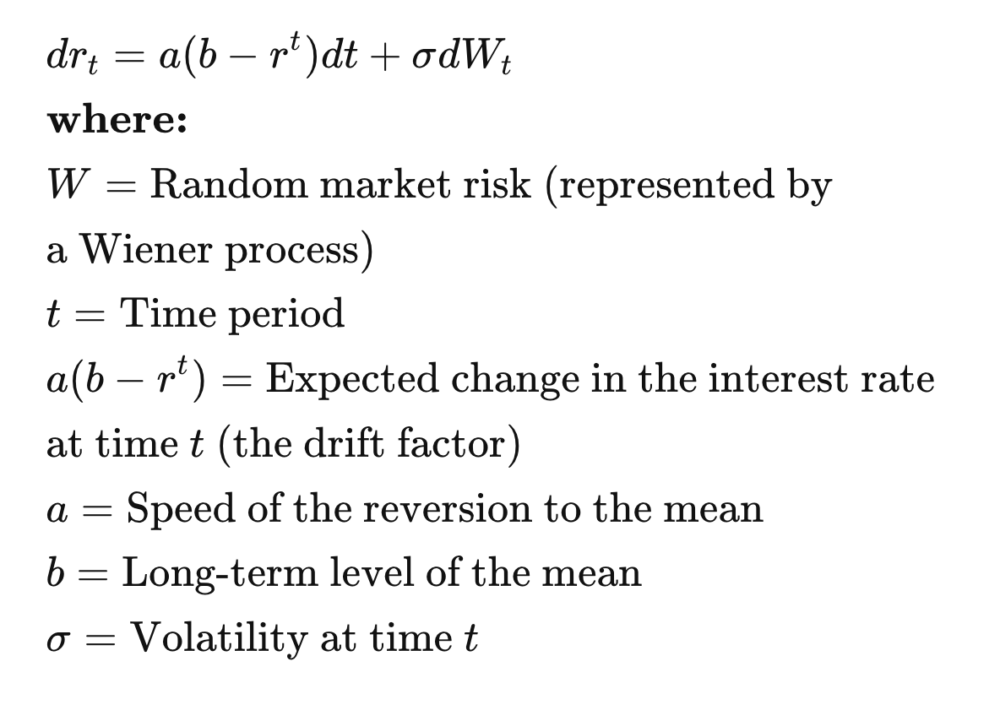

In [17]:
Image(wd + '/Vasicek Interest Rate Model Formula.png', width = 400)

In [18]:
def VasicekNextRate(r, kappa, theta, sigma, dt=1/252):
    # Implements above closed form solution     
    val1 = np.exp(-1*kappa*dt)
    val2 = (sigma**2)*(1-val1**2) / (2*kappa)
    out = r*val1 + theta*(1-val1) + (np.sqrt(val2))*np.random.normal()
    return out



def VasicekSim(N, r0, kappa, theta, sigma, dt = 1/252):
    short_r = [0]*N # Create array to store rates     short_r[0] = r0 # Initialise rates at $r_0$     
    
    for i in range(1,N):
        short_r[i] = VasicekNextRate(short_r[i-1], kappa, theta, sigma, dt)
    
    return short_r




def VasicekMultiSim(M, N, r0, kappa, theta, sigma, dt = 1/252):
    sim_arr = np.ndarray((N, M))
    
    for i in range(0,M):
        sim_arr[:, i] = VasicekSim(N, r0, kappa, theta, sigma, dt)
    
    return sim_arr



def VasicekCalibration(rates, dt=1/252):
    n = len(rates)
    
    # Implement MLE to calibrate parameters 
    Sx = sum(rates[0:(n-1)])
    Sy = sum(rates[1:n])
    Sxx = np.dot(rates[0:(n-1)], rates[0:(n-1)])
    Sxy = np.dot(rates[0:(n-1)], rates[1:n])
    Syy = np.dot(rates[1:n], rates[1:n])
    
    theta = (Sy * Sxx - Sx * Sxy) / (n * (Sxx - Sxy) - (Sx**2 - Sx*Sy))
    kappa = -np.log((Sxy - theta * Sx - theta * Sy + n * theta**2) / (Sxx - 2*theta*Sx + n*theta**2)) / dt
    a = np.exp(-kappa * dt)
    sigmah2 = (Syy - 2*a*Sxy + a**2 * Sxx - 2*theta*(1-a)*(Sy - a*Sx) + n*theta**2 * (1-a)**2) / n
    sigma = np.sqrt(sigmah2*2*kappa / (1-a**2))
    r0 = rates[n-1]
    
    return [kappa, theta, sigma, r0]

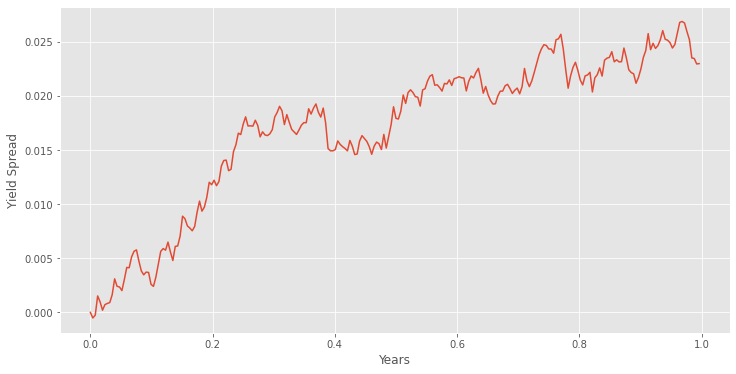

In [19]:
params = VasicekCalibration(yieldsp.loc[:, 'yieldsp'].dropna()/100)
#params = VasicekCalibration(yieldsp.dropna()/100)
kappa = params[0]
theta = params[1]
sigma = params[2]
r0 = params[3]

years = 1
N = years * 252
t = np.arange(0,N)/252

test_sim = VasicekSim(N, r0, kappa, theta, sigma, 1/252)
plt.plot(t,test_sim)
plt.ylabel("Yield Spread")
plt.xlabel("Years")
plt.show()

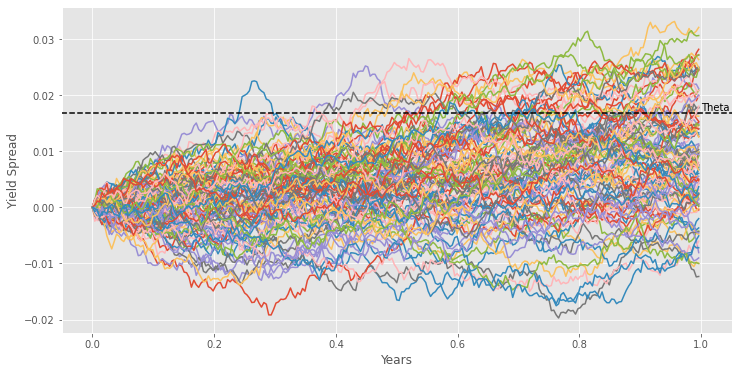

In [20]:
M = 100
rates_arr = VasicekMultiSim(M, N, r0, kappa, theta, sigma)

plt.plot(t,rates_arr)
plt.hlines(y=theta, xmin = -100, xmax=100, zorder=10, linestyles = 'dashed', label='Theta')
plt.annotate('Theta', xy=(1.0, theta + 0.0005))
plt.xlim(-0.05, 1.05)
plt.ylabel("Yield Spread")
plt.xlabel("Years")
plt.show()


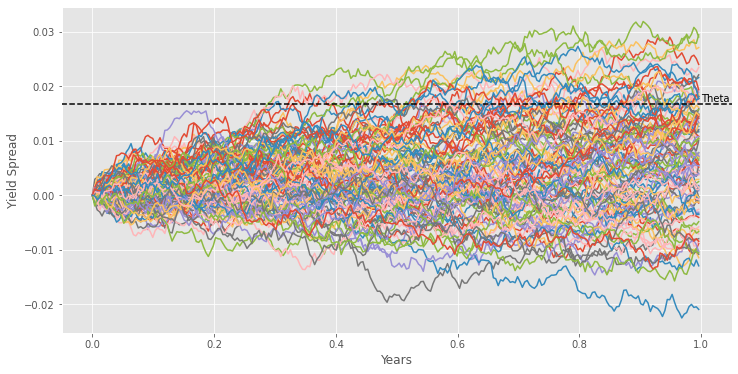

In [21]:
M = 100
rates_arr = VasicekMultiSim(M, N, -0.01, kappa, theta, sigma)
plt.plot(t,rates_arr)
plt.hlines(y=theta, xmin = -100, xmax=100, zorder=10, linestyles = 'dashed', label='Theta')
plt.annotate('Theta', xy=(1.0, theta+0.0005))
plt.xlim(-0.05, 1.05)
plt.ylabel("Yield Spread")
plt.xlabel("Years")
plt.show()


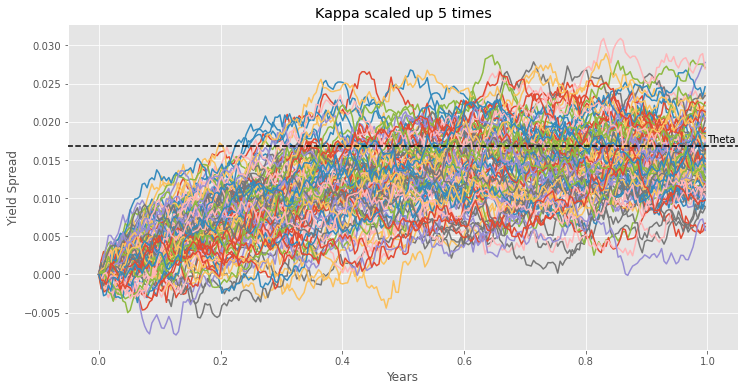

In [22]:
M = 100
rates_arr = VasicekMultiSim(M, N, -0.01, kappa*5, theta, sigma)
plt.plot(t,rates_arr)
plt.hlines(y=theta, xmin = -100, xmax=100, zorder=10, linestyles = 'dashed', label='Theta')
plt.annotate('Theta', xy=(1.0, theta+0.0005))
plt.xlim(-0.05, 1.05)
plt.ylabel("Yield Spread")
plt.xlabel("Years")
plt.title("Kappa scaled up 5 times")
plt.show()


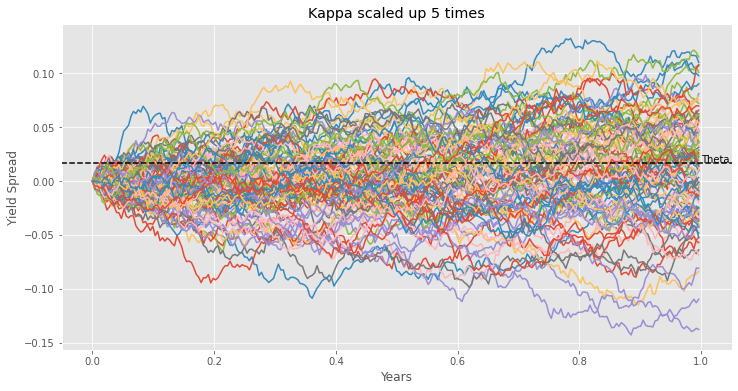

In [23]:
M = 100
rates_arr = VasicekMultiSim(M, N, -0.01, kappa, theta, sigma*5)
plt.plot(t,rates_arr)
plt.hlines(y=theta, xmin = -100, xmax=100, zorder=10, linestyles = 'dashed', label='Theta')
plt.annotate('Theta', xy=(1.0, theta+0.0005))
plt.xlim(-0.05, 1.05)
plt.ylabel("Yield Spread")
plt.xlabel("Years")
plt.title("Kappa scaled up 5 times")
plt.show()


The top-right plot shows the kernel density estimate (KDE) of the standardized residuals, which suggests the errors are Gaussian with a mean close to zero.

A more accurate statistic of the residuals suggest that the mean is 0. If the nean is non-zero, then the prediction may be biased positively.

In [ ]:
model_results.resid.describe()

In [ ]:
# start parameter = perform an in-sample prediction of the most recent five years' prices. 
# end parameter= perform an out-of-sample forecast of the next five days.

n = len(data['yieldsp'].index) # converts into datetime index
pred = model_results.get_prediction(
start = n-5, 
end = n+5
)
pred_ci = pred.conf_int()

#pred_ci.index = pd.date_range("2020-06-15", "2020-06-25", periods=len(pred_ci.index))
pred_ci.index = pd.date_range(start="2020-06-20",end="2020-06-29" )

# inspect the top three forecasted confidence interval values
pred_ci.tail()

In [ ]:
plt.figure(figsize=(15, 8))
ax = data['yieldsp']['2020':].plot(label='actual')

pred_ci.plot(
ax = ax, style=['--', '--'],
label='predicted/forecasted')

ci_index = pred_ci.index
lower_ci = pred_ci.iloc[:, 0]
upper_ci = pred_ci.iloc[:, 1]

ax.fill_between(ci_index, lower_ci, upper_ci,
color='r', alpha=.1)

ax.set_xlabel('Years')
ax.set_ylabel('Yield Spread')

plt.legend()
plt.show()

In [ ]:
def adfuller_test(series, signif = 0.05, name = '', verbose = False):
    """Perform ADFuller to test for stationarity of a given series and print report"""
    
    r = adfuller(series, autolag = 'AIC')
    output = {'test_statistic': round(r[0], 4), 'pvalue': round(r[1], 4), 'n_lags':round(r[2], 4), 'n_obs':r[3]}
    p_value = output['pvalue']
    def adjust(val, length = 6): return str(val).ljust(length)
    
    # print sumamry
    print(f'     Augmented Dickey-Fuller Test on "{name}"', "\n    ", '-'*47)
    print(f'  Null Hypothesis: Data has unit too. Non-Stationary.')
    print(f'  Significance Level    = {signif}')
    print(f'  Test Statistic        = {output["test_statistic"]}')
    print(f'  No. of Lags Chosen    = {output["n_lags"]}')
          
    for key, val in r[4].items():
          print(f'  Critical Value {adjust(key)} = {round(val, 3)}')
          
    if p_value <= signif:
          print(f" => P-Value = {p_value}. Rejecting null hypothesis.")
          print(f" => Series is stationary.")
    else:
          print(f" => P-Value = {p_value}. Weak evidence to reject the Null Hypothesis.")
          print(f" => Series is non-stationary.")

In [ ]:
# ADF test on the entire series of yield curve from Jan 1, 1982 to June 30,2020 => stationary
adfuller_test(yieldsp['yieldsp'], signif = 0.05, name = 'Yield Spread', verbose = False)

In [ ]:
# ADF test on partial series of yield curve from Oct 1, 1993 to July 01,2020 => non-stationary
adfuller_test(data['yieldsp'], signif = 0.05, name = 'Yield Spread', verbose = False)

In [ ]:
# makes the ACF plot: 
plot_acf(yieldsp, lags = 20, title = 'ACF Plot of Yield Curve from Jan 1,1982 to July 01,2020');

# the plots show strong autocorrelation of lags as spikes very gradually reduce.
pyplot.show()

The partial autocorrelation (PAC) measures the correlation between yt and yt−n after controlling for correlations at intermediate lags. In other words, the PAC at lag n is the regression coefficient on yt−n when yt is regressed on a constant and yt−1,…, yt−n.

In [ ]:
# makes the PACF plot => try MA(4)
plot_pacf(yieldsp, lags = 20, title = 'PACF Plot of Yield Curve from Jan 1,1982 to July 01,2020')
# The PACF shows a significant lag for perhaps 3 days, with significant lags spotty out to perhaps 20 days.

pyplot.show()

In [ ]:
# Since the partial data on yield spread has unit root, => stationarize it by differencing
diff = data['yieldsp'].diff().to_frame()

# drops rows with NaN values, and replaces inf values with 0
yield_diff = diff.dropna(inplace = False).replace([np.inf, -np.inf], 0).dropna(axis=1)

adfuller_test(yield_diff['yieldsp'], signif = 0.05, name = 'Yield Spread', verbose = False)

In [ ]:
# makes the ACF plot of the differenced yield curve => try AR(3)
plot_acf(yield_diff['yieldsp'], lags = 20, 
          title = 'ACF Plot of the Differenced Yield Curve from October 1,1993 to July 1,2020')

pyplot.show()

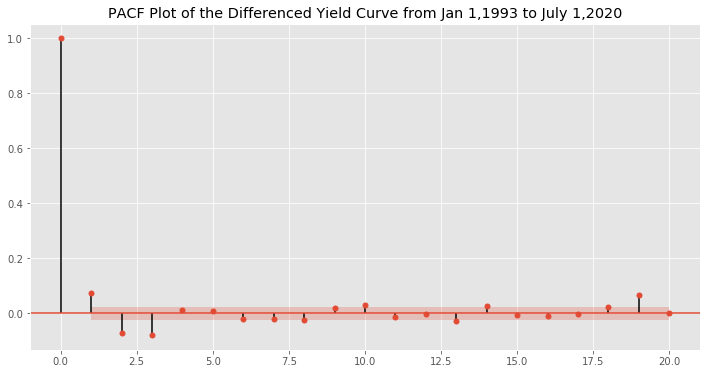

In [467]:
# makes the PACF plot of the differenced yield curve => try MA(3)
plot_pacf(yield_diff['yieldsp'], lags = 20, 
          title = 'PACF Plot of the Differenced Yield Curve from Jan 1,1993 to July 1,2020')

pyplot.show()

### ARIMA Model

The foundation of time series models is based on the assumption that the disturbance term is a white noise process. The implication of this assumption is that the last period's disturbance term cannot be used to predict the current disturbance term and that the disturbance term has constant variance. In other words, the implication of this assumption is the absence of serial correlation (or predictability) and homoscedasticity (or conditional constant variance). ARMA models that allow for serial dependence in the observations.

 The moving average (MA) models are treated as simple extensions of a white noise series. In other words, an MA model is a linear regression model of the current value of the series against the unobserved white noise error terms or shocks.

In [509]:
# fit model in the whole dataset
model = ARIMA(yieldsp, order=(1,0,4)) 
# ARIMA(6,1,4) has a lower AIC of -22345.248 than ARIMA(1,0,4)
# disp = 0: turns off the debug info about the fit of the ARIMA model
model_fit = model.fit(disp=0)
print(model_fit.summary())

/Users/joshi27s/opt/anaconda3/envs/tsa_course/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:225: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.



                              ARMA Model Results                              
Dep. Variable:                yieldsp   No. Observations:                 9627
Model:                     ARMA(1, 4)   Log Likelihood               11115.234
Method:                       css-mle   S.D. of innovations              0.076
Date:                Thu, 02 Jul 2020   AIC                         -22216.468
Time:                        15:00:58   BIC                         -22166.261
Sample:                             0   HQIC                        -22199.441
                                                                              
                    coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------
const             1.7282      0.340      5.089      0.000       1.063       2.394
ar.L1.yieldsp     0.9980      0.001   1573.795      0.000       0.997       0.999
ma.L1.yieldsp     0.0507      0.010     

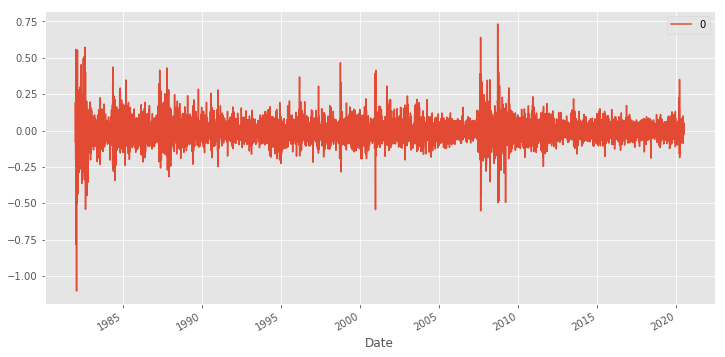

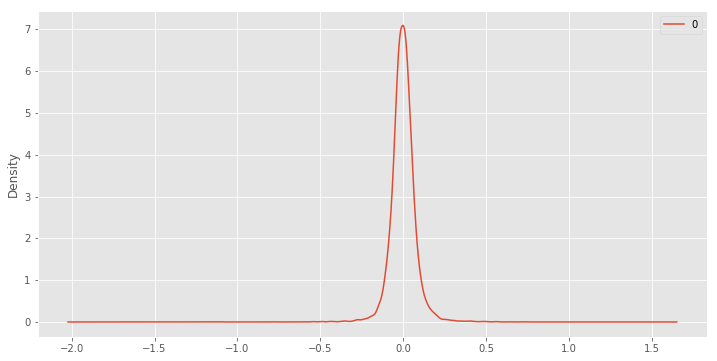

                 0
count  9626.000000
mean      0.000002
std       0.075734
min      -1.103890
25%      -0.037628
50%      -0.001376
75%       0.035934
max       0.732831


In [477]:
# plot residual errors
residuals = DataFrame(model_fit.resid)
residuals.plot()
pyplot.show()

# Density plot
residuals.plot(kind='kde')
pyplot.show()
print(residuals.describe())

The line plot of residuals suggest that the model captures of the trend information. The density plot suggests that the errors are Gaussian, and centered at zero. From the distribution of the errors, the mean = 0.000002 is almost 0. So, there is no bias in the predictions. 

In [482]:
# fit the model on the train set and generate prediction for each element on the test set.
# perform a rolling forecast : re-create the ARIMA forecast when each new observation is received. 
# forecast(): performs a one-step forecast from the model
# history - list created to track all the observations seeded with the training set
# => after each iteration, all new observations are appended to the list "history",


X = yieldsp.values
size = int(len(X) * 0.95)
train, test = X[0:size], X[size:len(X)]
history = [x for x in train]
predictions = list()

# walk-forward validation
for t in range(len(test)):
    model = ARIMA(history, order=(1,0,4))
    model_fit = model.fit(disp=0)
    output = model_fit.forecast()
    yhat = output[0]
    predictions.append(yhat)
    obs = test[t]
    history.append(obs)
    print('predicted=%f, expected=%f' % (yhat, obs))
        

predicted=0.996081, expected=0.960000
predicted=0.959644, expected=0.940000
predicted=0.937272, expected=0.930000
predicted=0.932651, expected=0.970000
predicted=0.976372, expected=0.960000
predicted=0.961283, expected=0.940000
predicted=0.938876, expected=0.890000
predicted=0.890094, expected=0.920000
predicted=0.926603, expected=0.900000
predicted=0.904008, expected=0.870000
predicted=0.870388, expected=0.820000
predicted=0.821397, expected=0.820000
predicted=0.826457, expected=0.810000
predicted=0.815923, expected=0.790000
predicted=0.792929, expected=0.800000
predicted=0.804365, expected=0.820000
predicted=0.825086, expected=0.760000
predicted=0.758940, expected=0.770000
predicted=0.773067, expected=0.730000
predicted=0.733980, expected=0.740000
predicted=0.744833, expected=0.730000
predicted=0.734124, expected=0.730000
predicted=0.733365, expected=0.750000
predicted=0.754091, expected=0.760000
predicted=0.762924, expected=0.750000
predicted=0.750487, expected=0.750000
predicted=0.

predicted=-0.186016, expected=-0.140000
predicted=-0.134684, expected=-0.120000
predicted=-0.118026, expected=-0.110000
predicted=-0.109900, expected=-0.090000
predicted=-0.087902, expected=-0.110000
predicted=-0.108823, expected=-0.140000
predicted=-0.138902, expected=-0.160000
predicted=-0.155599, expected=-0.150000
predicted=-0.142644, expected=-0.130000
predicted=-0.123366, expected=-0.040000
predicted=-0.032330, expected=-0.110000
predicted=-0.113064, expected=-0.120000
predicted=-0.121044, expected=-0.100000
predicted=-0.092192, expected=-0.130000
predicted=-0.125815, expected=-0.120000
predicted=-0.116395, expected=-0.180000
predicted=-0.177457, expected=-0.220000
predicted=-0.216062, expected=-0.250000
predicted=-0.242544, expected=-0.190000
predicted=-0.177959, expected=-0.210000
predicted=-0.205293, expected=-0.190000
predicted=-0.187351, expected=-0.130000
predicted=-0.123134, expected=-0.040000
predicted=-0.033726, expected=-0.020000
predicted=-0.022106, expected=-0.070000


predicted=0.507757, expected=0.560000
predicted=0.571151, expected=0.490000
predicted=0.487333, expected=0.470000
predicted=0.469230, expected=0.530000
predicted=0.540140, expected=0.510000
predicted=0.512997, expected=0.470000
predicted=0.467336, expected=0.510000
predicted=0.516069, expected=0.500000
predicted=0.504509, expected=0.480000
predicted=0.479903, expected=0.550000
predicted=0.556476, expected=0.510000
predicted=0.510625, expected=0.530000
predicted=0.530342, expected=0.550000
predicted=0.554220, expected=0.520000
predicted=0.520220, expected=0.510000
predicted=0.510865, expected=0.530000
predicted=0.535478, expected=0.600000
predicted=0.606803, expected=0.520000
predicted=0.515504, expected=0.570000
predicted=0.572163, expected=0.610000
predicted=0.617143, expected=0.560000
predicted=0.557254, expected=0.510000
predicted=0.507311, expected=0.510000
predicted=0.516635, expected=0.520000
predicted=0.527421, expected=0.600000
predicted=0.607035, expected=0.570000
predicted=0.

In [502]:
pred = pd.DataFrame(predictions, columns = ['Predictions'])
#yieldsp.iloc[-len(test):,] #=> finds the 963rd row from the bottom => date is Aug 28, 2018


pred.index = pd.date_range(start="2019-03-08",end="2020-07-01" )
test = pd.DataFrame(test, columns = ['Test'])
test.index = pd.date_range(start="2019-03-08",end="2020-07-01" )
merge = pd.merge(pred, test, how='inner', left_index=True, right_index=True)
merge.tail()

,Predictions,Test
2020-06-27,0.541265,0.52
2020-06-28,0.521581,0.50
2020-06-29,0.503341,0.50
2020-06-30,0.504954,0.50
2020-07-01,0.504407,0.55


In [504]:
error = mean_squared_error(test, predictions)
rmse = sqrt(error)
print('RMSE: %.3f' % rmse)

RMSE: 0.048


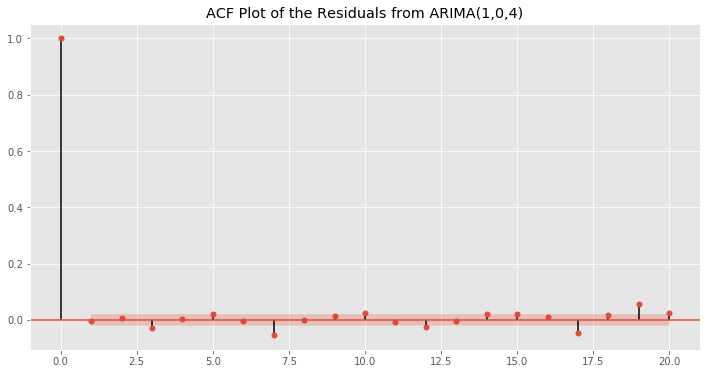

In [505]:
# makes the ACF plot of the differenced yield curve
plot_acf(residuals, lags = 20, 
          title = 'ACF Plot of the Residuals from ARIMA(1,0,4)')

pyplot.show()

In [507]:
# line plot shows the expected values (red) compared to the rolling forecast predictions (blue).
test_df = go.Scatter(x = merge.index, y = merge['Test'], line=dict(color='red', width= 1))

layout = go.Layout(title='Yield Spread (10 Year - 2 Month Treasury Rate)', 
                   title_font_size=15, 
                   xaxis_title="Years", yaxis_title="Yield Spread", 
                   xaxis_range=[datetime.datetime(2019, 3, 8),
                   datetime.datetime(2020, 7, 1)])

pred_df = go.Scatter(x = merge.index,
                        y= merge['Predictions'],
                        line=dict(color='blue', width= 1),
                        opacity=1,
                        name='Predictions',
                        yaxis='y2')


# Create a layout with two yaxes
layout = go.Layout(height=600, width=1000, font=dict(size=15),
                   title='Predicted and Actual Yield Spread',
                   xaxis=dict(title='Date', type='date'),
                   
                   yaxis=dict(title='Test', color='red'),
                   # Add a second yaxis to the right of the plot
                   yaxis2=dict(title='Predicted', color='blue',
                                          overlaying='y',
                                          side='right'),
                   xaxis_range=[datetime.datetime(2019, 3, 8),
                   datetime.datetime(2020, 7, 1)]
                   )

fig = go.Figure(data=[test_df, pred_df], layout=layout)
iplot(fig)

In [510]:
X = yieldsp.values
    

# multi-step out-of-sample forecast
start_index = len(yieldsp)
end_index = start_index + 6

forecast = model_fit.predict(start=start_index, end=end_index)

# invert the differenced forecast to something usable
history = [x for x in X]

day = date(2020,7,2)

for yhat in forecast:
    print('{}: {}'.format(day, yhat))
    history.append(forecast)
    day += timedelta(days=1)

2020-07-02: 0.5556588983431237
2020-07-03: 0.5574054358668811
2020-07-04: 0.5567467541834609
2020-07-05: 0.5578343826603729
2020-07-06: 0.5602062411023236
2020-07-07: 0.562573292816929
2020-07-08: 0.5649355475453386


/Users/joshi27s/opt/anaconda3/envs/tsa_course/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:531: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.



In [511]:
X = data['yieldsp'].values


# invert the differenced operation by adding the value of the observation one day ago. 
# => do this to any forecasts made by a model trained on the differenced data.

def invert_diff(history, yhat, interval=1):
    return yhat + history[-interval]

# fit model
model = ARIMA(yield_diff, order=(3,0,3))
mod_fit = model.fit(disp=0)
mod_fit.summary()

/Users/joshi27s/opt/anaconda3/envs/tsa_course/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:225: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.



<class 'statsmodels.iolib.summary.Summary'>
"""
                              ARMA Model Results                              
==============================================================================
Dep. Variable:                yieldsp   No. Observations:                 6690
Model:                     ARMA(3, 3)   Log Likelihood                8722.620
Method:                       css-mle   S.D. of innovations              0.066
Date:                Thu, 02 Jul 2020   AIC                         -17429.239
Time:                        15:01:59   BIC                         -17374.772
Sample:                             0   HQIC                        -17410.428
                                                                              
=================================================================================
                    coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------
const            -0.0003      0.001     -0.376      0.707      -0.002       0.001
ar.L1.yieldsp     1.2872      0.084     15.363      0.000       1.123       1.451
ar.L2.yieldsp    -1.2548      0.073    -17.196      0.000      -1.398      -1.112
ar.L3.yieldsp     0.7448      0.080      9.267      0.000       0.587       0.902
ma.L1.yieldsp    -1.2503      0.085    -14.736      0.000      -1.417      -1.084
ma.L2.yieldsp     1.1679      0.083     14.034      0.000       1.005       1.331
ma.L3.yieldsp    -0.7136      0.078     -9.200      0.000      -0.866      -0.562
                                    Roots                                    
=============================================================================
                  Real          Imaginary           Modulus         Frequency
-----------------------------------------------------------------------------
AR.1            0.2508           -1.0353j            1.0653           -0.2122
AR.2            0.2508           +1.0353j            1.0653            0.2122
AR.3            1.1832           -0.0000j            1.1832           -0.0000
MA.1            1.1650           -0.0000j            1.1650           -0.0000
MA.2            0.2357           -1.0711j            1.0967           -0.2155
MA.3            0.2357           +1.0711j            1.0967            0.2155
-----------------------------------------------------------------------------
"""

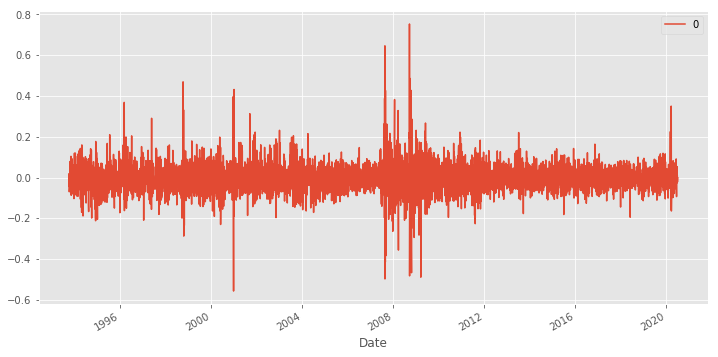

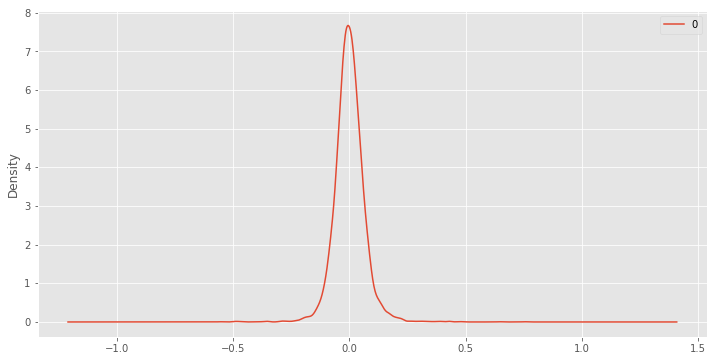

                 0
count  6690.000000
mean     -0.000002
std       0.065697
min      -0.556162
25%      -0.035127
50%      -0.001567
75%       0.033893
max       0.753454


In [512]:
# plot residual errors
residuals = DataFrame(mod_fit.resid)
residuals.plot()
pyplot.show()
residuals.plot(kind='kde')
pyplot.show()
print(residuals.describe())

In [513]:
X = data['yieldsp'].values


# multi-step out-of-sample forecast
start_index = len(yield_diff)
end_index = start_index + 6

forecast = mod_fit.predict(start=start_index, end=end_index)


# invert the differenced forecast to something usable
history = [x for x in X]
day = date(2020,7,2)
gap = 1

for yhat in forecast:
    inverted = invert_diff(history, yhat, gap)
    print('{}: {}'.format(day, inverted))
    history.append(inverted)
    day += timedelta(days=1)

2020-07-02: 0.4992677854471461
2020-07-03: 0.49845047279289084
2020-07-04: 0.49899636289700555
2020-07-05: 0.5001176881712021
2020-07-06: 0.5002057943577272
2020-07-07: 0.4992571803636659
2020-07-08: 0.49869915510461327


/Users/joshi27s/opt/anaconda3/envs/tsa_course/lib/python3.7/site-packages/statsmodels/tsa/base/tsa_model.py:531: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.



## Prophet by Facebook

Prophet works well on datasets that have piecewise trends and weekly/yearly seasonality. Prophet works well when a dataset has strong, consistent seasonalities and trends that can reasonably be modeled with a piecewise function. 

https://peerj.com/preprints/3190/

In [17]:
yieldsp1 = yieldsp.reset_index().rename(columns={'Date':'ds', 'yieldsp':'y'})
pred_size = 30

# define the train set => hold iut the last 30 wentries for prediction and validation
train = yieldsp1[:-pred_size] 

# initialize Prophet => fit the model to the train data and make predictions
m = Prophet()
m.fit(train)

# by default, it includes the historic observations 
future = m.make_future_dataframe(periods = pred_size)

# forecast object is a new dataframe that includes a column yhat with the forecast, 
# and columns for components and uncertainty intervals.
forecast = m.predict(future)
forecast.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
9957,2021-05-15,0.173426,-0.281205,1.348145,-0.050715,0.427084,0.341831,0.341831,0.341831,0.244755,0.244755,0.244755,0.097075,0.097075,0.097075,0.0,0.0,0.0,0.515257
9958,2021-05-16,0.172667,-0.306516,1.330340,-0.052500,0.427184,0.341516,0.341516,0.341516,0.244755,0.244755,0.244755,0.096760,0.096760,0.096760,0.0,0.0,0.0,0.514183
9959,2021-05-17,0.171908,-0.639928,0.957129,-0.053024,0.427285,-0.006497,-0.006497,-0.006497,-0.103000,-0.103000,-0.103000,0.096503,0.096503,0.096503,0.0,0.0,0.0,0.165411
9960,2021-05-18,0.171150,-0.655616,0.943117,-0.053549,0.427385,-0.013315,-0.013315,-0.013315,-0.109598,-0.109598,-0.109598,0.096283,0.096283,0.096283,0.0,0.0,0.0,0.157835
9961,2021-05-19,0.170391,-0.576509,0.970491,-0.054073,0.427486,0.000476,0.000476,0.000476,-0.095602,-0.095602,-0.095602,0.096077,0.096077,0.096077,0.0,0.0,0.0,0.170867


In [18]:
# Black dots: actual values, dark blue lines: predicted values of yield spread
# The light blue shade is 95% confidence interval around the forecast.

# This returns a plotly Figure
fig = plot_plotly(m, forecast, xlabel = 'Date', ylabel = 'Yield Spread', changepoints= True)  
py.iplot(fig)

In [19]:
m.changepoints.head() # view the dates where the chagepoints occurred

307    1983-03-25
614    1984-06-18
921    1985-09-11
1228   1986-12-05
1535   1988-03-01
Name: ds, dtype: datetime64[ns]

In [20]:
trace = go.Scatter(
    name = 'Actual price',
    mode = 'lines',
    x = list(yieldsp1['ds']),
    y = list(yieldsp1['y']),
    marker=dict(
        color='yellow',
        line=dict(width=1)
    ))

trace1 = go.Scatter(
    name = 'trend',
    mode = 'lines',
    x = list(forecast['ds']),
    y = list(forecast['yhat']),
    marker=dict(
        color='red',
        line=dict(width=3)
    ))

upper_band = go.Scatter(
    name = 'upper band',
    mode = 'lines',
    x = list(forecast['ds']),
    y = list(forecast['yhat_upper']),
    line= dict(color='#57b88f'),
    fill = 'tonexty'
)

lower_band = go.Scatter(
    name= 'lower band',
    mode = 'lines',
    x = list(forecast['ds']),
    y = list(forecast['yhat_lower']),
    line= dict(color='#1705ff')
)

tracex = go.Scatter(
    name = 'Actual price',
   mode = 'markers',
   x = list(yieldsp1['ds']),
   y = list(yieldsp1['y']),
   marker=dict(
      color='black',
      line=dict(width=2)
   ))

data = [tracex, trace1, lower_band, upper_band, trace]

layout = dict(title='Forecasting Yield Spread Using FbProphet',
             xaxis=dict(title = 'Dates', ticklen=2, zeroline=True))

figure=dict(data=data,layout=layout)
py.offline.iplot(figure)

In [22]:
def make_comparison_dataframe(historical, forecast):
    """Join the history with the forecast.
    
       The resulting dataset will contain columns 'yhat', 'yhat_lower', 'yhat_upper' and 'y'.
    """
    return forecast.set_index('ds')[['yhat', 'yhat_lower', 'yhat_upper']].join(historical.set_index('ds'))

cmp = make_comparison_dataframe(train, forecast).dropna()
error = mean_squared_error(cmp['yhat'], cmp['y'])
rmse = sqrt(error)
print('RMSE: %.3f' % rmse)

RMSE: 0.550


## LSTM
Predict values for a timeseries given the history of yield spread observations. We are going to use a multi-layered LSTM recurrent neural network to predict the last value of a sequence of values.

Create dataset, normalize the dataset, split into training and test sets, convert an array of values into a dataset matrix

The following data pre-processing and feature engineering need to be done before construct the LSTM model.

Create the dataset, ensure all data is float. Normalize the features. Split into training and test sets. Convert an array of values into a dataset matrix. Reshape into X=t and Y=t+1. Reshape input to be 3D (num_samples, num_timesteps, num_features).

In [34]:
# Train-test split : last 10 percent of the observations are in the test set
train_d, test_d = np.split(yieldsp, [int(.95 *len(yieldsp))])

dataset = train_d['yieldsp'].values #numpy.ndarray
dataset = dataset.astype('float32')
dataset = np.reshape(dataset, (-1, 1))
scaler = MinMaxScaler(feature_range=(0, 1))
dataset = scaler.fit_transform(dataset)
train_size = int(len(dataset) * 0.80)
test_size = len(dataset) - train_size
train, test = dataset[0:train_size,:], dataset[train_size:len(dataset),:]

def create_dataset(dataset, look_back=1):
    X, Y = [], []
    for i in range(len(dataset)-look_back-1):
        a = dataset[i:(i+look_back), 0]
        X.append(a)
        Y.append(dataset[i + look_back, 0])
    return np.array(X), np.array(Y)
    
look_back = 30
X_train, Y_train = create_dataset(train, look_back)
X_test, Y_test = create_dataset(test, look_back)

# reshape input to be [samples, time steps, features]
X_train = np.reshape(X_train, (X_train.shape[0], 1, X_train.shape[1]))
X_test = np.reshape(X_test, (X_test.shape[0], 1, X_test.shape[1]))

In [35]:
X_train.shape

(7285, 1, 30)

In [36]:
Y_train.shape

(7285,)

## Model Architecture

Define the LSTM with 100 neurons in the first hidden layer and 1 neuron in the output layer for predicting yieldsp. The input shape will be 1 time step with 30 features.

Dropout 20%.

Use the MSE loss function and the efficient Adam version of stochastic gradient descent.

The model will be fit for 20 training epochs with a batch size of 70.

In [37]:
model = Sequential()
model.add(LSTM(100, input_shape=(X_train.shape[1], X_train.shape[2])))
model.add(Dropout(0.2))
model.add(Dense(1))
model.compile(loss='mean_squared_error', optimizer='adam')

history = model.fit(X_train, Y_train, epochs=20, batch_size=70, validation_data=(X_test, Y_test), 
                    callbacks=[EarlyStopping(monitor='val_loss', patience=10)], verbose=1, shuffle=False)

# Training Phase
model.summary()

Train on 7285 samples, validate on 1798 samples
Epoch 1/20
7285/7285 [==============================] - 2s 298us/step - loss: 0.0202 - val_loss: 8.9003e-04
Epoch 2/20
7285/7285 [==============================] - 1s 103us/step - loss: 0.0034 - val_loss: 0.0020
Epoch 3/20
7285/7285 [==============================] - 1s 103us/step - loss: 0.0035 - val_loss: 0.0035
Epoch 4/20
7285/7285 [==============================] - 1s 104us/step - loss: 0.0040 - val_loss: 0.0072
Epoch 5/20
7285/7285 [==============================] - 1s 99us/step - loss: 0.0044 - val_loss: 0.0094
Epoch 6/20
7285/7285 [==============================] - 1s 98us/step - loss: 0.0050 - val_loss: 0.0138
Epoch 7/20
7285/7285 [==============================] - 1s 98us/step - loss: 0.0044 - val_loss: 0.0111
Epoch 8/20
7285/7285 [==============================] - 1s 98us/step - loss: 0.0037 - val_loss: 0.0084
Epoch 9/20
7285/7285 [==============================] - 1s 100us/step - loss: 0.0031 - val_loss: 0.0081
Epoch 10/20
7285

In [38]:
# make predictions
train_predict = model.predict(X_train)
test_predict = model.predict(X_test)

# invert predictions
train_predict = scaler.inverse_transform(train_predict)
Y_train = scaler.inverse_transform([Y_train])
test_predict = scaler.inverse_transform(test_predict)
Y_test = scaler.inverse_transform([Y_test])

print('Train Mean Absolute Error:', mean_absolute_error(Y_train[0], train_predict[:,0]))
print('Train Root Mean Squared Error:',np.sqrt(mean_squared_error(Y_train[0], train_predict[:,0])))
print('Test Mean Absolute Error:', mean_absolute_error(Y_test[0], test_predict[:,0]))
print('Test Root Mean Squared Error:',np.sqrt(mean_squared_error(Y_test[0], test_predict[:,0])))

Train Mean Absolute Error: 0.4348256134101163
Train Root Mean Squared Error: 0.46337825611365163
Test Mean Absolute Error: 0.5065089305660018
Test Root Mean Squared Error: 0.5145076270854897


In [41]:
#history.history
mod_loss = pd.DataFrame(history.history, columns=['loss', 'val_loss'])
mod_loss.head()

,loss,val_loss
0,0.020202,0.000890
1,0.003363,0.001977
2,0.003499,0.003522
3,0.003993,0.007211
4,0.004416,0.009422


In [42]:
fig_loss = mod_loss.iplot(asFigure=True, kind='scatter', xTitle='Epochs', yTitle='Loss')
fig_loss

In [45]:
train_d.head(1798)

,yieldsp
Date,
1982-01-04,2.32
1982-01-05,2.24
1982-01-06,2.43
1982-01-07,2.46
1982-01-08,2.50
...,...
1989-03-13,0.26
1989-03-14,0.30
1989-03-15,0.32


In [46]:
# line plot shows the expected values (red) compared to the rolling forecast predictions (blue).
# 1798 = length of the validation set
test_df = go.Scatter(x = train_d.index, y = Y_test[0][:1798], line=dict(color='red', width= 1))

layout = go.Layout(title='Yield Spread (10 Year - 2 Month Treasury Rate)', 
                   title_font_size=15, 
                   xaxis_title="Years", yaxis_title="Yield Spread", 
                   # train_d.head(1798) tells the start and end date => look at the datetime index
                   xaxis_range=[datetime.datetime(1982, 1, 4),
                   datetime.datetime(1989, 3, 17)])

pred_df = go.Scatter(x = train_d.index,
                        y = test_predict[:,0][:1798],
                        line=dict(color='blue', width= 1),
                        opacity=1,
                        name='Predictions',
                        yaxis='y2')


# Create a layout with two yaxes
layout = go.Layout(height=600, width=1000, font=dict(size=15),
                   title='Actual and Predicted Yield Spread from LSTM',
                   xaxis=dict(title='Date', type='date'),
                   
                   yaxis=dict(title='Actual', color='red'),
                   # Add a second yaxis to the right of the plot
                   yaxis2=dict(title='Predicted', color='blue',
                                          overlaying='y',
                                          side='right'),
                   xaxis_range=[datetime.datetime(1982, 1, 4),
                   datetime.datetime(1989, 3, 17)]
                   )

fig = go.Figure(data=[test_df, pred_df], layout=layout)
iplot(fig)

In [48]:
def create_X_Y(ts: list, lag: int) -> tuple:
    """
    A method to create X and Y matrix from a time series list for the training of 
    deep learning models 
    """
    X, Y = [], []

    if len(ts) - lag <= 0:
        X.append(ts)
    else:
        for i in range(len(ts) - lag):
            Y.append(ts[i + lag])
            X.append(ts[i:(i + lag)])

    X, Y = np.array(X), np.array(Y)

    # Reshaping the X array to an LSTM input shape 
    X = np.reshape(X, (X.shape[0], X.shape[1], 1))

    return X, Y

# Deep learning packages
from keras.models import Sequential
from keras.layers import LSTM, Dense

# Defining the number of neurons in the LSTM layer
n_layer = 50

# Defining how many lags will be used in the time series
n_lag = 3

# Defining the model
model = Sequential()
model.add(LSTM(n_layer, activation='relu', input_shape=(n_lag, 1)))
model.add(Dense(1))

# The objective functions which will be minimized is mean squared error (mse)
model.compile(optimizer='adam', loss='mse')

class DeepModelTS():
    """
    A class to create a deep time series model
    """
    def __init__(
        self, 
        data: pd.DataFrame, 
        Y_var: str,
        lag: int,
        LSTM_layer_depth: int, 
        epochs=10, 
        batch_size=256,
        train_test_split=0
    ):

        self.data = data 
        self.Y_var = Y_var 
        self.lag = lag 
        self.LSTM_layer_depth = LSTM_layer_depth
        self.batch_size = batch_size
        self.epochs = epochs
        self.train_test_split = train_test_split

    @staticmethod
    def create_X_Y(ts: list, lag: int) -> tuple:
        """
        A method to create X and Y matrix from a time series list for the training of 
        deep learning models 
        """
        X, Y = [], []

        if len(ts) - lag <= 0:
            X.append(ts)
        else:
            for i in range(len(ts) - lag):
                Y.append(ts[i + lag])
                X.append(ts[i:(i + lag)])

        X, Y = np.array(X), np.array(Y)

        # Reshaping the X array to an LSTM input shape 
        X = np.reshape(X, (X.shape[0], X.shape[1], 1))

        return X, Y         

    def create_data_for_NN(
        self,
        use_last_n=None
        ):
        """
        A method to create data for the neural network model
        """
        # Extracting the main variable we want to model/forecast
        y = self.data[self.Y_var].tolist()

        # Subseting the time series if needed
        if use_last_n is not None:
            y = y[-use_last_n:]

        # The X matrix will hold the lags of Y 
        X, Y = self.create_X_Y(y, self.lag)

        # Creating training and test sets 
        X_train = X
        X_test = []

        Y_train = Y
        Y_test = []

        if self.train_test_split > 0:
            index = round(len(X) * self.train_test_split)
            X_train = X[:(len(X) - index)]
            X_test = X[-index:]     
            
            Y_train = Y[:(len(X) - index)]
            Y_test = Y[-index:]

        return X_train, X_test, Y_train, Y_test

    def LSTModel(self):
        """
        A method to fit the LSTM model 
        """
        # Getting the data 
        X_train, X_test, Y_train, Y_test = self.create_data_for_NN()

        # Defining the model
        model = Sequential()
        model.add(LSTM(self.LSTM_layer_depth, activation='relu', input_shape=(self.lag, 1)))
        model.add(Dense(1))
        model.compile(optimizer='adam', loss='mse')

        # Defining the model parameter dict 
        keras_dict = {
            'x': X_train,
            'y': Y_train,
            'batch_size': self.batch_size,
            'epochs': self.epochs,
            'shuffle': False
        }

        if self.train_test_split > 0:
            keras_dict.update({
                'validation_data': (X_test, Y_test)
            })

        # Fitting the model 
        model.fit(
            **keras_dict
        )

        # Saving the model to the class 
        self.model = model

        return model

    def predict(self) -> list:
        """
        A method to predict using the test data used in creating the class
        """
        yhat = []

        if(self.train_test_split > 0):
        
            # Getting the last n time series 
            _, X_test, _, _ = self.create_data_for_NN()        

            # Making the prediction list 
            yhat = [y[0] for y in self.model.predict(X_test)]

        return yhat

    def predict_n_ahead(self, n_ahead: int):
        """
        A method to predict n time steps ahead
        """    
        X, _, _, _ = self.create_data_for_NN(use_last_n=self.lag)        

        # Making the prediction list 
        yhat = []

        for _ in range(n_ahead):
            # Making the prediction
            fc = self.model.predict(X)
            yhat.append(fc)

            # Creating a new input matrix for forecasting
            X = np.append(X, fc)

            # Ommiting the first variable
            X = np.delete(X, 0)

            # Reshaping for the next iteration
            X = np.reshape(X, (1, len(X), 1))

In [50]:
# Initiating the class
deep_learner = DeepModelTS(
data = train_d, # the data used for modeling.
Y_var = 'yieldsp',  # the variable name we want to model/forecast.
lag = 24,
LSTM_layer_depth = 50,  # number of neurons in the LSTM layer.
epochs = 10,
batch_size = 256,
train_test_split = 0.15
)

# Fitting the model
model = deep_learner.LSTModel()

Train on 7753 samples, validate on 1368 samples
Epoch 1/10
7753/7753 [==============================] - 4s 510us/step - loss: 2.1612 - val_loss: 0.8644
Epoch 2/10
7753/7753 [==============================] - 2s 305us/step - loss: 0.5499 - val_loss: 0.5439
Epoch 3/10
7753/7753 [==============================] - 2s 301us/step - loss: 0.1662 - val_loss: 0.0242
Epoch 4/10
7753/7753 [==============================] - 2s 321us/step - loss: 0.0616 - val_loss: 0.0195
Epoch 5/10
7753/7753 [==============================] - 2s 298us/step - loss: 0.0321 - val_loss: 0.0159
Epoch 6/10
7753/7753 [==============================] - 2s 296us/step - loss: 0.0654 - val_loss: 0.0219
Epoch 7/10
7753/7753 [==============================] - 2s 295us/step - loss: 0.0508 - val_loss: 0.0108
Epoch 8/10
7753/7753 [==============================] - 2s 304us/step - loss: 0.0320 - val_loss: 0.0070
Epoch 9/10
7753/7753 [==============================] - 2s 296us/step - loss: 0.0267 - val_loss: 0.0064
Epoch 10/10
7753

In [52]:
# Defining the lag that we used for training of the model 
lag_model = 24

# Getting the last period
ts = train_d['yieldsp'].tail(lag_model).values.tolist()

# Creating the X matrix for the model
X, _ = deep_learner.create_X_Y(ts, lag=lag_model)

# Getting the forecast
yhat = model.predict(X)

yhat = deep_learner.predict()

# Constructing the forecast dataframe
fc = train_d.tail(len(yhat)).copy()

#fc.reset_index(inplace=True)
fc['forecast'] = yhat
fc.head()

,yieldsp,forecast
Date,,
2013-02-08,1.92,1.944218
2013-02-11,1.90,1.943715
2013-02-12,1.93,1.939260
2013-02-13,1.95,1.937706
2013-02-14,1.89,1.939453


In [58]:
fig_lstm = fc.iplot(asFigure=True, kind='scatter', xTitle='Date', yTitle='Yield Spread')
fig_lstm

In [56]:
from math import sqrt
error = mean_squared_error(fc['yieldsp'], fc['forecast'])
rmse = sqrt(error)
print('RMSE: %.3f' % rmse)

RMSE: 0.079


In [59]:
# Forecasting n steps ahead => ERROR
n_ahead = 10
yhat = deep_learner.predict_n_ahead(n_ahead)
#yhat = [y[0][0] for y in yhat]

## References:

https://www.gid.works/2018/10/09/3d-yield-curve.html - 3D graph of the yield curve

https://clinthoward.github.io/portfolio/2017/08/19/Rates-Simulations/ - PCA and Vasicek model simulations

https://machinelearningmastery.com/arima-for-time-series-forecasting-with-python/ - ARIMA models

https://machinelearningmastery.com/make-sample-forecasts-arima-python/ - Out of sample forecasting

https://machinelearningmastery.com/time-series-forecasting-methods-in-python-cheat-sheet/ - Classical models including ARIMAX, VARMAX

https://www.machinelearningplus.com/time-series/arima-model-time-series-forecasting-python/

https://towardsdatascience.com/energy-consumption-time-series-forecasting-with-python-and-lstm-deep-learning-model-7952e2f9a796 - LSTM

https://machinelearningmastery.com/multivariate-time-series-forecasting-lstms-keras/ - LSTM with exog variables